# Players, referees and ball tracking model training

## Before You start

### Configure API keys

- Open your [Kaggle setting](https://www.kaggle.com/settings) and click **"Create New Token"**. File **kaggle.json** will be downloaded.
- Create **.env** file in **content** directory
- Copy your **username** and **key** into **.env**. It should look like this
```
USERNAME=<your username>
KEY=<your key>
```

### Ensure that you have access to GPU

In [ ]:
!nvidia-smi

## Prepare environment

In [ ]:
!pip install kaggle ultralytics python-dotenv

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/football-analytics/runs/

In [53]:
import kagglehub
import shutil
import pandas as pd
import yaml
import os
import cv2
import seaborn as sns
from dotenv import load_dotenv
from matplotlib import pyplot as plt
from IPython.display import Image, display
from ultralytics import YOLO

## Download dataset

In [ ]:
dataset_id = "danielmachniak/football-players-detection"

download_path = kagglehub.dataset_download(dataset_id)
dest_path = "./football-analytics/data/raw/"

shutil.move(download_path, dest_path)

## Data analysis

### Raw image

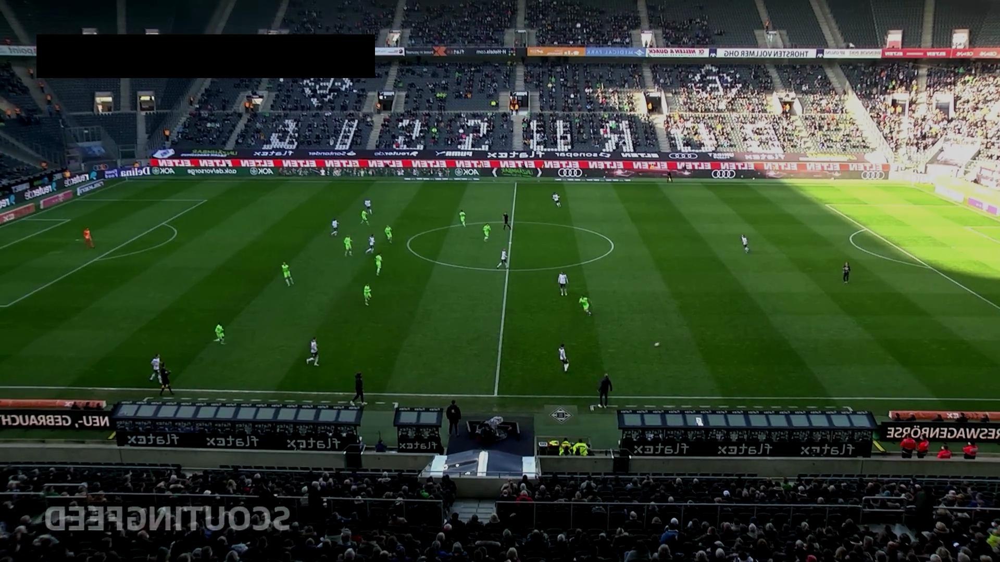

In [7]:
raw_data_path = dest_path + "football-players-detection/"

train_images_path = raw_data_path + "train/images/"
images = sorted(os.listdir(train_images_path))

raw_image_path = train_images_path + images[0]

display(Image(raw_image_path))

### Labels format

In [8]:

with open("./football-analytics/data/raw/football-players-detection/data.yaml") as f:
    data_info = yaml.safe_load(f)

classes = data_info["names"]

print(classes)

train_labels_path = raw_data_path + "train/labels/"
labels_filenames = sorted(os.listdir(train_labels_path))

label_path = train_labels_path + labels_filenames[0]

labels = pd.read_csv(
label_path,
delimiter=" ",
names=["class", "x_center", "y_center", "width", "height"]
)

labels["class"] = labels["class"].apply(lambda x: classes[x])

labels

['ball', 'goalkeeper', 'player', 'referee']


,class,x_center,y_center,width,height
0,referee,0.669370,0.312333,0.006052,0.025333
1,player,0.557771,0.356426,0.011292,0.033222
2,referee,0.506250,0.393519,0.008333,0.033333
3,player,0.370573,0.432870,0.008854,0.036111
4,goalkeeper,0.088802,0.422139,0.011979,0.038889
5,player,0.367448,0.523611,0.008854,0.041667
6,player,0.348177,0.437037,0.009896,0.038889
7,player,0.365365,0.386574,0.009896,0.028704
8,player,0.486719,0.412500,0.008854,0.034259
9,player,0.334635,0.404630,0.008854,0.033333


YOLO labels format is:
```
class x y width height
```
Box coordinates are in normalized xywh format (from 0 to 1). To get actual values boxes should be resized by the image dimensions.

### Distribution of classes in the dataset

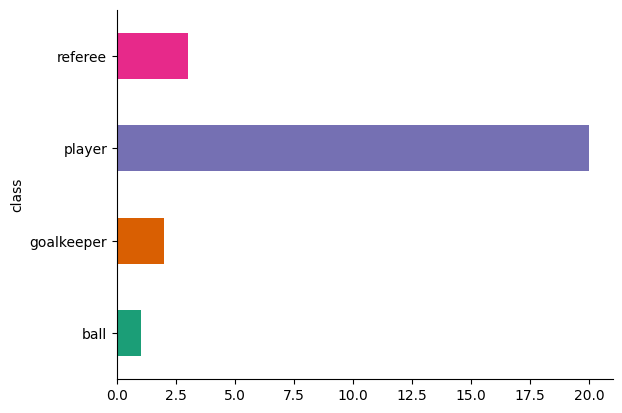

In [9]:
labels.groupby('class').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

There are very few examples of the ball in the dataset. Due to this and the small size of the object, some training of the model may be necessary.

### Bbox annotation on raw image

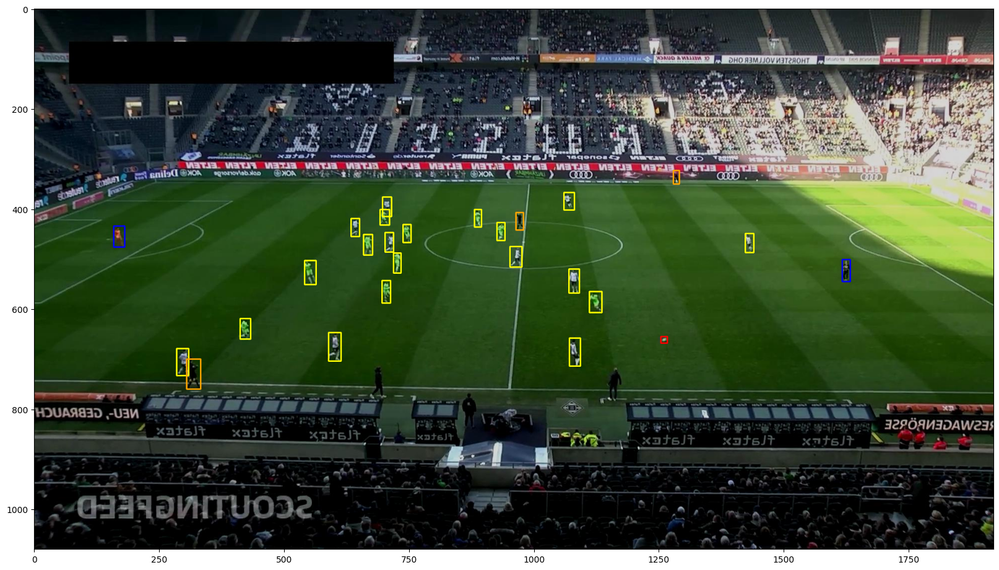

In [10]:
COLORS_BGR = [
    (0, 0, 255),      # Red
    (255, 0, 0),      # Blue
    (0, 255, 255),    # Yellow
    (0, 165, 255)     # Orange
]

annotated_img = cv2.imread(raw_image_path)

img_height, img_width, _ = annotated_img.shape

for _, bbox in labels.iterrows():
  x1 = int((bbox["x_center"] - bbox["width"] / 2) * img_width)
  y1 = int((bbox["y_center"] - bbox["height"] / 2) * img_height)
  x2 = int((bbox["x_center"] + bbox["width"] / 2) * img_width)
  y2 = int((bbox["y_center"] + bbox["height"] / 2) * img_height)

  cv2.rectangle(
    img=annotated_img,
    pt1=(x1, y1),
    pt2=(x2, y2),
    color=COLORS_BGR[classes.index(bbox["class"])],
    thickness=2
  )

plt.figure(figsize = [20,20])
plt.imshow(annotated_img[:,:,::-1])





### Label annotation on raw image

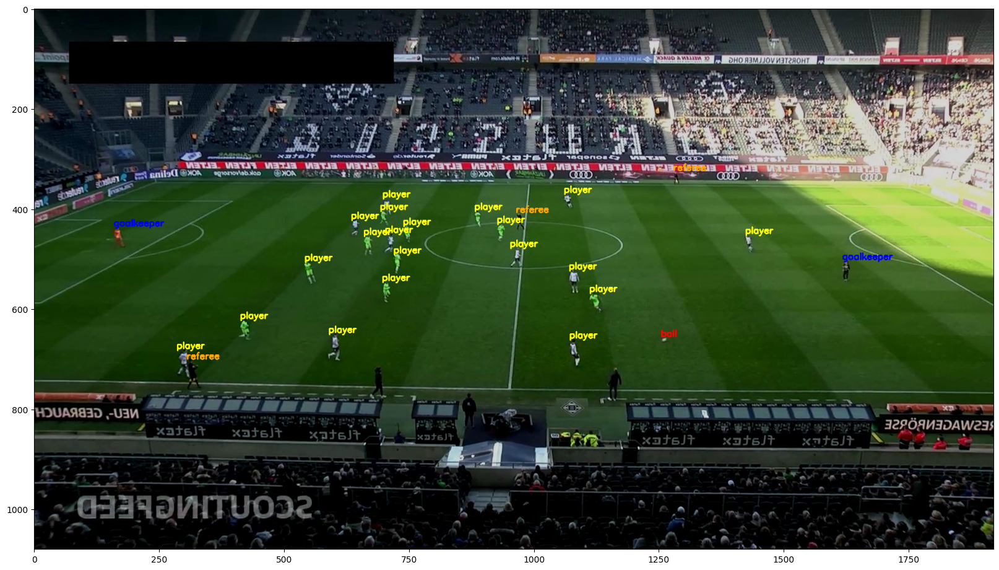

In [11]:
labeled_img = cv2.imread(raw_image_path)

img_height, img_width, _ = labeled_img.shape

for _, bbox in labels.iterrows():
  x1 = int((bbox["x_center"] - bbox["width"] / 2) * img_width)
  y1 = int((bbox["y_center"] - bbox["height"] / 2) * img_height)
  x2 = int((bbox["x_center"] + bbox["width"] / 2) * img_width)
  y2 = int((bbox["y_center"] + bbox["height"] / 2) * img_height)

  cv2.putText(
      img=labeled_img,
      text=bbox["class"],
      org=(x1, y1),
      fontFace=cv2.FONT_HERSHEY_SIMPLEX,
      fontScale=0.6,
      color=COLORS_BGR[classes.index(bbox["class"])],
      thickness=2
  )

plt.figure(figsize = [20,20])
plt.imshow(labeled_img[:,:,::-1])

## Data processing

### Resized image to 1280x1280

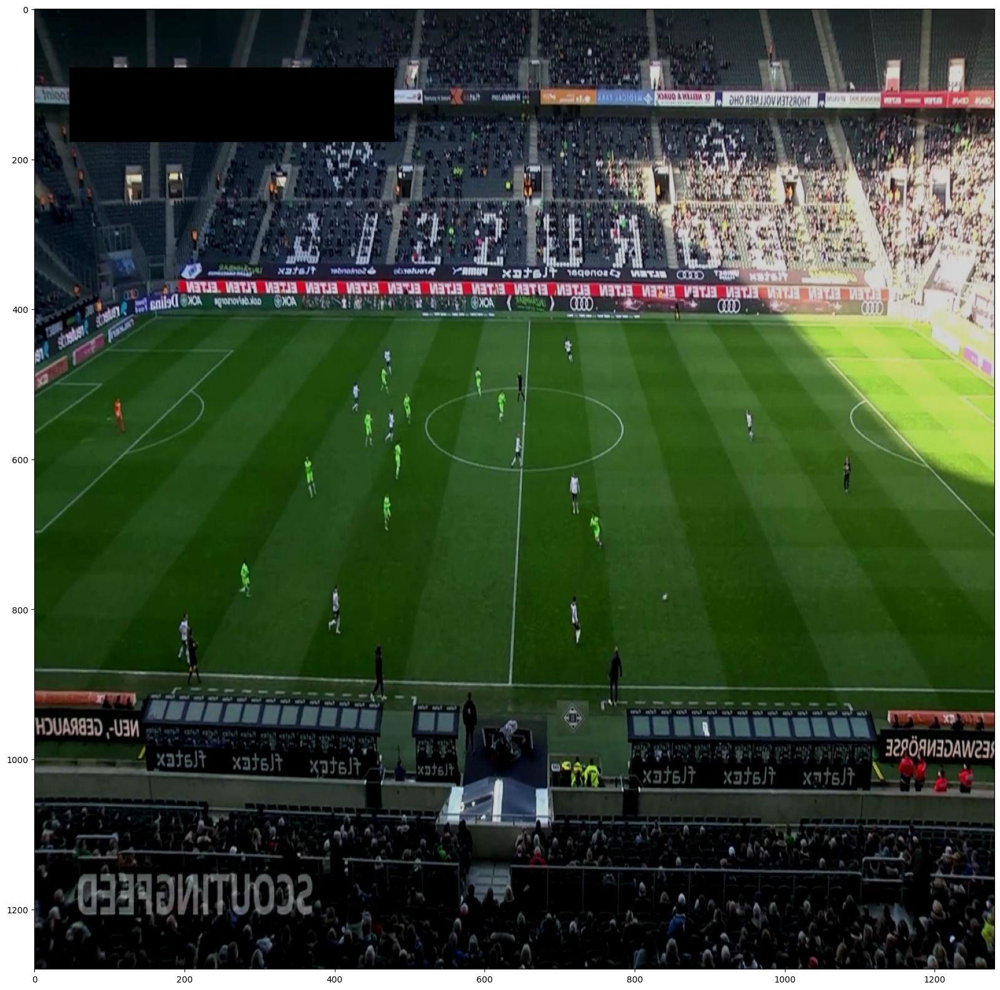

In [12]:
img = cv2.imread(raw_image_path)
resized_img = cv2.resize(img, (1280, 1280))

plt.figure(figsize = [20,20])
plt.imshow(resized_img[:,:,::-1])


### Data processing

In [13]:
processed_data_path = "./football-analytics/data/processed/football-players-detection/"

os.makedirs(processed_data_path, exist_ok=True)
shutil.copy(raw_data_path + "data.yaml", processed_data_path)

target_size = 1280

subdirs = ["train", "test", "valid"]

for subdir in subdirs:
  raw_images_dir = os.path.join(raw_data_path, subdir, 'images')
  raw_labels_dir = os.path.join(raw_data_path, subdir, 'labels')

  processed_images_dir = os.path.join(processed_data_path, subdir, 'images')
  processed_labels_dir = os.path.join(processed_data_path, subdir, 'labels')

  os.makedirs(processed_images_dir, exist_ok=True)
  os.makedirs(processed_labels_dir, exist_ok=True)

  for filename in os.listdir(raw_images_dir):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
      img_path = os.path.join(raw_images_dir, filename)
      label_path = os.path.join(raw_labels_dir, filename.replace('.jpg', '.txt').replace('.jpeg', '.txt').replace('.png', '.txt'))

      img = cv2.imread(img_path)
      original_height, original_width, _ = img.shape
      resized_img = cv2.resize(img, (target_size, target_size))
      cv2.imwrite(os.path.join(processed_images_dir, filename), resized_img)

      if os.path.exists(label_path):
        shutil.copy(label_path, os.path.join(processed_labels_dir, filename.replace('.jpg', '.txt').replace('.jpeg', '.txt').replace('.png', '.txt')))

### Processed image

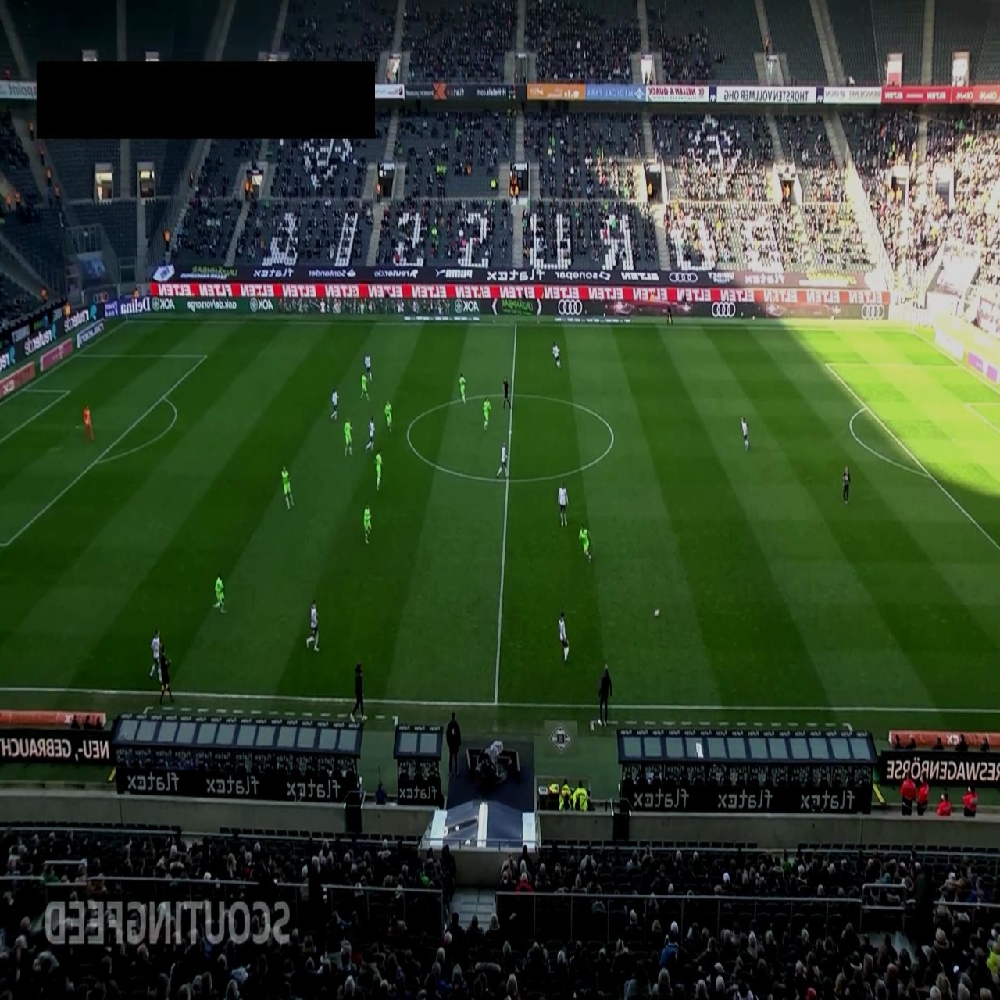

In [14]:
images = sorted(os.listdir(processed_data_path + "train/images/"))

processed_image_path = processed_data_path + "train/images/" + images[0]

display(Image(processed_image_path))

### Bbox anntation on processed image

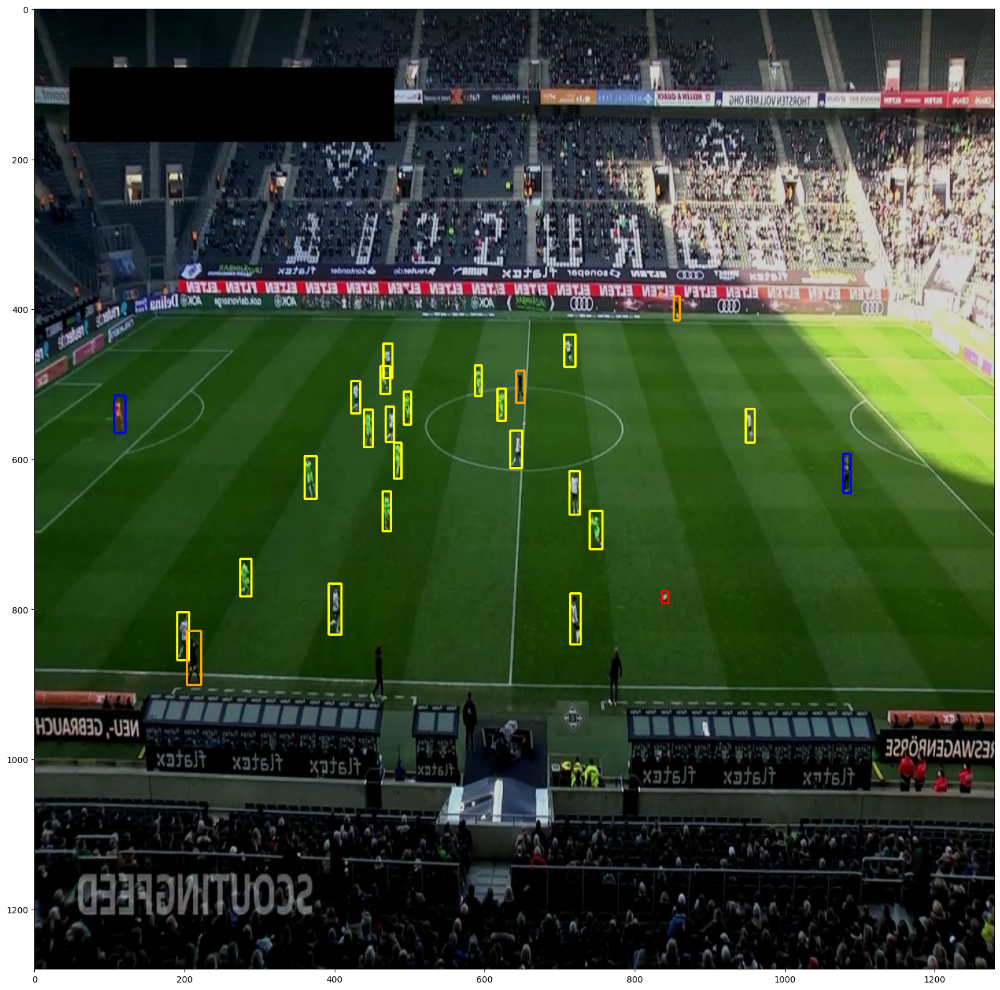

In [15]:
annotated_img = cv2.imread(processed_image_path)

img_height, img_width, _ = annotated_img.shape

labels = pd.read_csv(
          processed_data_path + "train/labels/" + os.path.basename(processed_image_path).replace('.jpg', '.txt').replace('.jpeg', '.txt').replace('.png', '.txt'),
          delimiter=" ",
          names=["class", "x_center", "y_center", "width", "height"]
          )

labels["class"] = labels["class"].apply(lambda x: classes[x])

for _, bbox in labels.iterrows():
  x1 = int((bbox["x_center"] - bbox["width"] / 2) * img_width)
  y1 = int((bbox["y_center"] - bbox["height"] / 2) * img_height)
  x2 = int((bbox["x_center"] + bbox["width"] / 2) * img_width)
  y2 = int((bbox["y_center"] + bbox["height"] / 2) * img_height)

  cv2.rectangle(
    img=annotated_img,
    pt1=(x1, y1),
    pt2=(x2, y2),
    color=COLORS_BGR[classes.index(bbox["class"])],
    thickness=2
  )

plt.axis("off")
plt.figure(figsize = [20,20])
plt.imshow(annotated_img[:,:,::-1])

## Model fine-tuning

In [ ]:
model = YOLO("yolo11x.pt")

In [ ]:
%cd /content/football-analytics/

model.train(
  task="detect",
  data="/content/football-analytics/data/processed/football-players-detection/data.yaml",
  epochs=200,
  patience=50,
  batch=0.8,
  imgsz=1280,
  plots=True
)


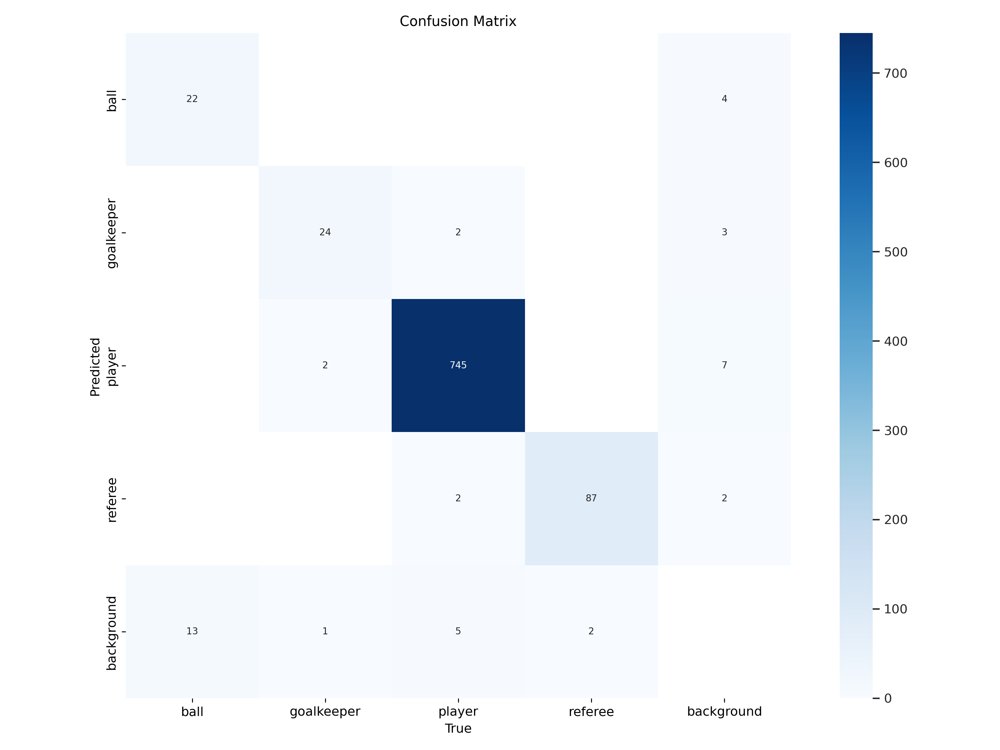

In [18]:
Image(
    filename="/content/football-analytics/runs/detect/train/confusion_matrix.png",
    )

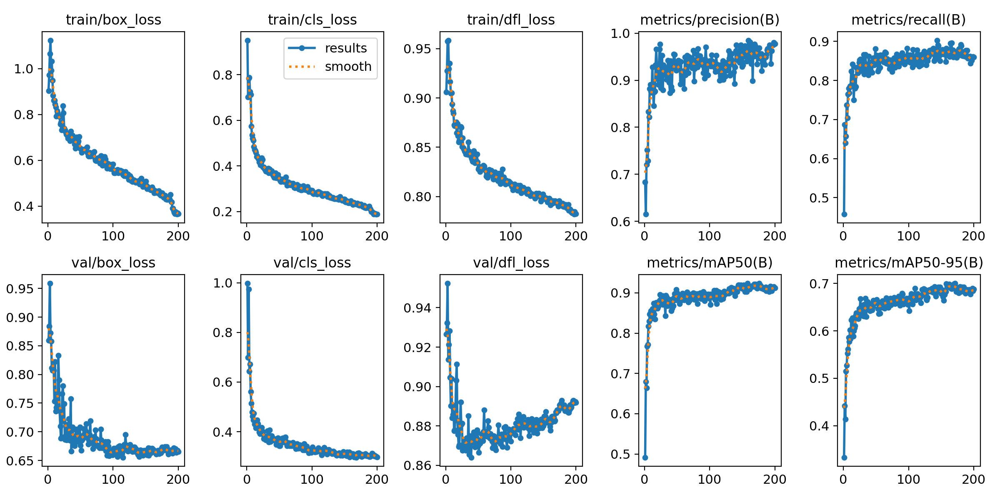

In [23]:
Image(
    filename="/content/football-analytics/runs/detect/train/results.png",
    )

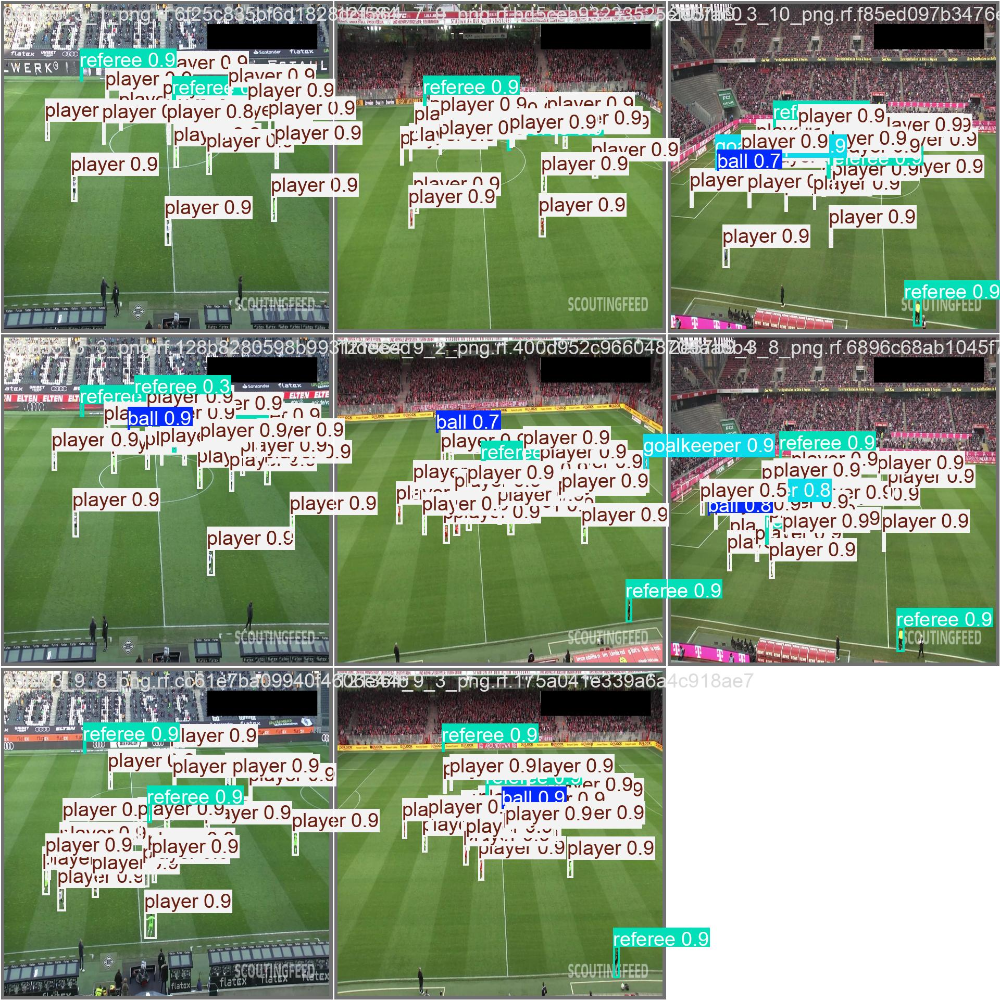

In [26]:
Image(
    filename="/content/football-analytics/runs/detect/train/val_batch0_pred.jpg",
    )

## Model validation

In [16]:
model = YOLO("/content/football-analytics/runs/detect/train/weights/best.pt")

In [17]:
metrics = model.val()

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (NVIDIA L4, 22478MiB)
YOLO11x summary (fused): 464 layers, 56,831,644 parameters, 0 gradients, 194.4 GFLOPs


val: Scanning /content/football-analytics/data/processed/football-players-detection/valid/labels.cache... 38 images, 0 backgrounds, 0 corrupt: 100%|██████████| 38/38 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:07<00:00,  2.38s/it]


                   all         38        905      0.944      0.859      0.913      0.714
                  ball         35         35      0.905      0.547      0.696      0.378
            goalkeeper         27         27      0.915      0.926      0.979      0.847
                player         38        754      0.992      0.985      0.995      0.869
               referee         38         89      0.963      0.978      0.984      0.762
Speed: 13.2ms preprocess, 100.9ms inference, 0.0ms loss, 8.0ms postprocess per image
Results saved to runs/detect/val


In [ ]:
model.predict(
    "/content/football-analytics/data/processed/football-players-detection/test/images",
    save=True
)

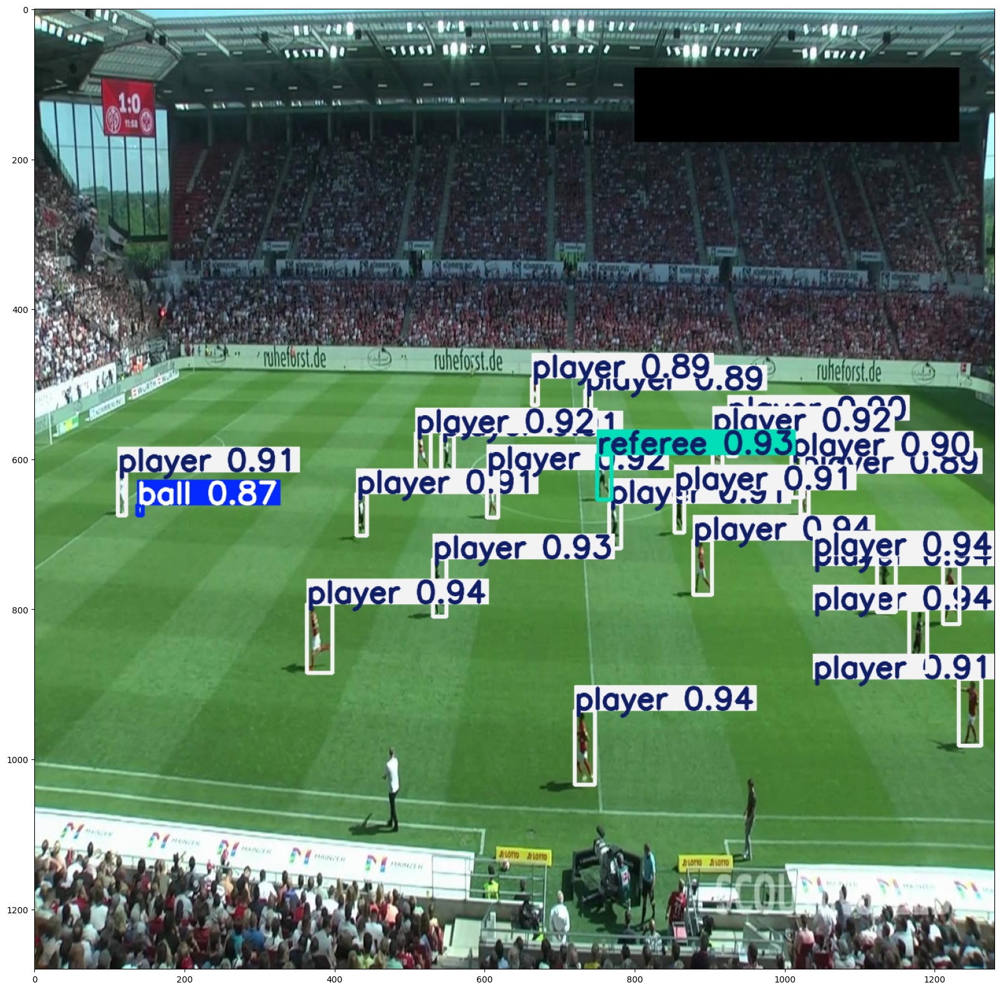

In [49]:
predict_dir = "/content/football-analytics/runs/detect/predict/"

predicted_images = sorted(os.listdir(predict_dir))

img = cv2.imread(predict_dir + predicted_images[0])

plt.figure(figsize = [20,20])
plt.imshow(img[:,:,::-1])

## Model uploading

In [ ]:
%cd /content

SRC_MODEL_DIR = '/content/football-analytics/runs/detect/train/weights/best.pt'
LOCAL_MODEL_DIR = '/content/football-analytics/runs/detect/train/weights/football-player-detector-x.pt'

shutil.move(SRC_MODEL_DIR, LOCAL_MODEL_DIR)

load_dotenv()
kagglehub.auth.set_kaggle_credentials(
  os.getenv("USERNAME"),
  os.getenv("KEY")
)

MODEL_SLUG = 'football_player_detector' # Replace with model slug.

# Learn more about naming model variations at
# https://www.kaggle.com/docs/models#name-model.
VARIATION_SLUG = 'x' # Replace with variation slug.

kagglehub.model_upload(
  handle = f"danielmachniak/{MODEL_SLUG}/pyTorch/{VARIATION_SLUG}",
  local_model_dir = LOCAL_MODEL_DIR,
  version_notes = 'Update 2024-11-10')